In [1]:
import numpy as np
import dapy.filters as filters
import dapy.utils.pou as pou
from dapy.models.damped_advection import SpatialDampedAdvectionModel
from dapy.utils.plotting import (
    plot_rank_histogram, 
    animate_2d_fields, 
    plot_slices_through_time, 
    plot_slices_through_space
)
import matplotlib.pyplot as plt
plt.style.use('seaborn-white')
plt.rcParams['figure.dpi'] = 100
plt.rcParams['animation.html'] = 'html5'

## Generate data from model

In [2]:
model_params = {
    'spatial_mesh_shape': (50, 50),
    'time_step': 1.,
    'observation_grid_shape': (10, 10),
    'domain_size': (1., 1.),
    'state_noise_length_scale': 0.0707,
    'state_noise_amplitude': 5.,
    'advection_coeff': (0.0625, 0.0625),
    'damping_coeff': np.log(2) / 2,
    'observation_noise_std': 1.,
    'observation_function': lambda x, t: x / np.tanh(x * 10)
}
model = SpatialDampedAdvectionModel(**model_params)

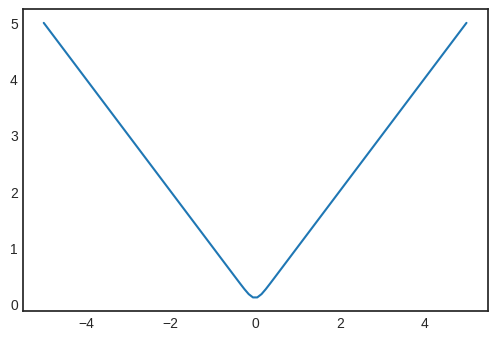

In [3]:
fig, ax = plt.subplots()
x = np.linspace(-5, 5, 100)
ax.plot(x, model_params['observation_function'](x, None))

In [4]:
observation_time_indices = np.arange(0, 200)
seed = 20220302
rng = np.random.default_rng(seed)
state_sequence, observation_sequence = model.sample_state_and_observation_sequences(
    rng, observation_time_indices, return_states_at_all_times=False
)

Sampling: 100%|██████████|200/200 [00:00<00:00, 284.12time-steps/s]

In [5]:
print(f'State sequence (min, max) = ({state_sequence.min():.2f}, {state_sequence.max():.2f})')
print(f'Observation sequence (min, max) = ({observation_sequence.min():.2f}, {observation_sequence.max():.2f})')

State sequence (min, max) = (-5.69, 5.70)
Observation sequence (min, max) = (-3.53, 6.82)


In [6]:
animation, fig, axes = animate_2d_fields({
    'True state field': state_sequence.reshape((-1,) + model.mesh_shape), 
    'Noisy observations': observation_sequence.reshape((-1,) + model.observation_grid_shape)
})
plt.close(fig)
display(animation)

## Infer state from observations

In [7]:
num_particle = 200

In [8]:
def plot_filter_results(filter_results, true_state_sequence, model):
    plot_space_slices = (model.mesh_shape[0] // 2, slice(None))
    plot_observation_time_indices =  range(
        0, observation_time_indices[-1], observation_time_indices[-1] // 4
    )
    plot_space_indices = range(0, model.dim_state, model.dim_state // 4)
    space_slices_fig, _ = plot_slices_through_space(
        filter_results,
        model.mesh_shape,
        plot_space_slices,
        plot_observation_time_indices,
        true_state_sequence,
        trace_alpha=0.5,
    )
    time_slices_fig, _ = plot_slices_through_time(
        filter_results, 
        plot_space_indices, 
        true_state_sequence,
        trace_alpha=0.5,
    )
    histogram_fig, _ = plot_rank_histogram(
        filter_results['state_particles_sequence'], 
        true_state_sequence
    )
    field_sequence_shape = (
        filter_results['state_mean_sequence'].shape[0], *model.mesh_shape
    )
    field_animation, animation_fig, _ = animate_2d_fields({
        'True state field': true_state_sequence.reshape(field_sequence_shape), 
        'Estimated mean state field': filter_results['state_mean_sequence'].reshape(field_sequence_shape),
        'Example particle': filter_results['state_particles_sequence'][:, 0].reshape(field_sequence_shape)
    })
    for fig in (space_slices_fig, time_slices_fig, histogram_fig):
        plt.close(fig)
        display(fig)
    plt.close(animation_fig)
    display(field_animation)

### Reference results from MCMC run

In [9]:
reference_results = np.load('damped-advection-model-reference-results.npz', 'r')

### Approximate inference with ensemble filters

In [11]:
localisation_radius = 0.2
ensemble_filters = {
    'Ensemble transform Kalman filter': filters.EnsembleTransformKalmanFilter(),
    'Particle filter': filters.BootstrapParticleFilter(),
    'Local ensemble transform Kalman filter': filters.LocalEnsembleTransformKalmanFilter(
        localisation_radius=localisation_radius
    ),
    'Local ensemble transform particle filter': filters.ScalableLocalEnsembleTransformParticleFilter(
        localisation_radius=localisation_radius,
        optimal_transport_solver_kwargs={'num_thread': 4},
        calculate_cost_matrices_func_kwargs={'num_thread': 4}
    ),
    'Smooth local ensemble transform particle filter': filters.ScalableLocalEnsembleTransformParticleFilter(
        localisation_radius=localisation_radius, 
        partition_of_unity=pou.SmoothedBlock2dPartitionOfUnityBasis(
            model, (10, 10), kernel_halfwidth=3, use_distance_from_patch_center=True
        ),
        optimal_transport_solver_kwargs={'num_thread': 4},
        calculate_cost_matrices_func_kwargs={'num_thread': 4}
    )
}

In [12]:
ensemble_filter_results = {}
for label, ensemble_filter in ensemble_filters.items():
    print(label)
    ensemble_filter_results[label] = ensemble_filter.filter(
        model=model, 
        observation_sequence=observation_sequence, 
        observation_time_indices=observation_time_indices, 
        num_particle=num_particle, 
        rng=rng, 
        return_particles=True
    )

Ensemble transform Kalman filter


Filtering: 100%|██████████|200/200 [00:21<00:00, 9.14time-steps/s]

Particle filter


Filtering: 100%|██████████|200/200 [00:21<00:00, 9.14time-steps/s]

Local ensemble transform Kalman filter


Filtering: 100%|██████████|200/200 [12:14<00:00, 3.67s/time-steps]

Local ensemble transform particle filter


Filtering: 100%|██████████|200/200 [20:40<00:00, 6.20s/time-steps]

Smooth local ensemble transform particle filter


Filtering: 100%|██████████|200/200 [04:40<00:00, 1.40s/time-steps]

In [13]:
for label, results in ensemble_filter_results.items():
    print(
        f"{label: <50} "
        f"RMSE(mean, truth) = {np.mean((results['state_mean_sequence'] - state_sequence)**2)**0.5:.2e}    "
        f"RMSE(mean, true mean) = {np.mean((results['state_mean_sequence'] - reference_results['state_mean_sequence'])**2)**0.5:.2e}    "
        f"RMSE(std, ref. std) = {np.mean((results['state_std_sequence'] - reference_results['state_std_sequence'])**2)**0.5:.2e}    "
    )

Ensemble transform Kalman filter                   RMSE(mean, truth) = 1.60e+00    RMSE(mean, true mean) = 8.56e-01    RMSE(std, ref. std) = 6.44e-01    
Particle filter                                    RMSE(mean, truth) = 1.78e+00    RMSE(mean, true mean) = 1.14e+00    RMSE(std, ref. std) = 1.05e+00    
Local ensemble transform Kalman filter             RMSE(mean, truth) = 1.35e+00    RMSE(mean, true mean) = 3.04e-01    RMSE(std, ref. std) = 6.13e-01    
Local ensemble transform particle filter           RMSE(mean, truth) = 1.38e+00    RMSE(mean, true mean) = 2.88e-01    RMSE(std, ref. std) = 2.69e-01    
Smooth local ensemble transform particle filter    RMSE(mean, truth) = 1.40e+00    RMSE(mean, true mean) = 2.80e-01    RMSE(std, ref. std) = 3.05e-01    


In [15]:
ensemble_filter_results["Particle filter"]["estimated_ess_sequence"].min()

1.0000074131110699

In [16]:
ensemble_filter_results["Local ensemble transform particle filter"]["per_patch_estimated_ess_sequence"].min()

1.116122912436487

In [17]:
ensemble_filter_results["Smooth local ensemble transform particle filter"]["per_patch_estimated_ess_sequence"].min()

1.1190387767199568

Ensemble transform Kalman filter


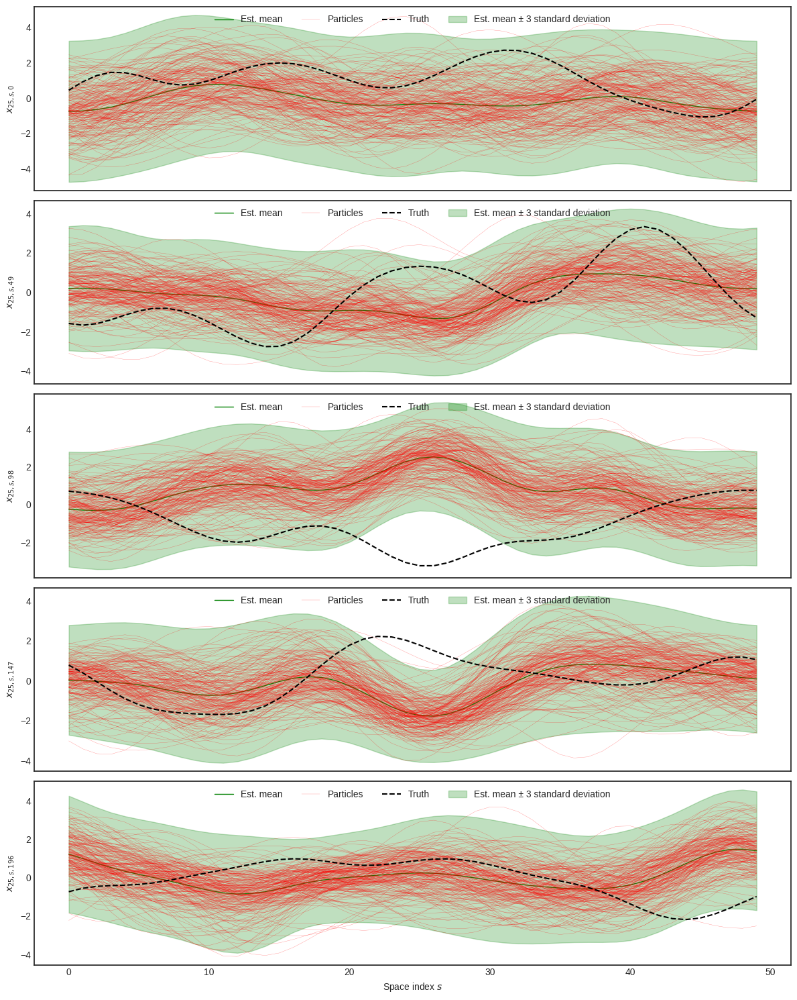

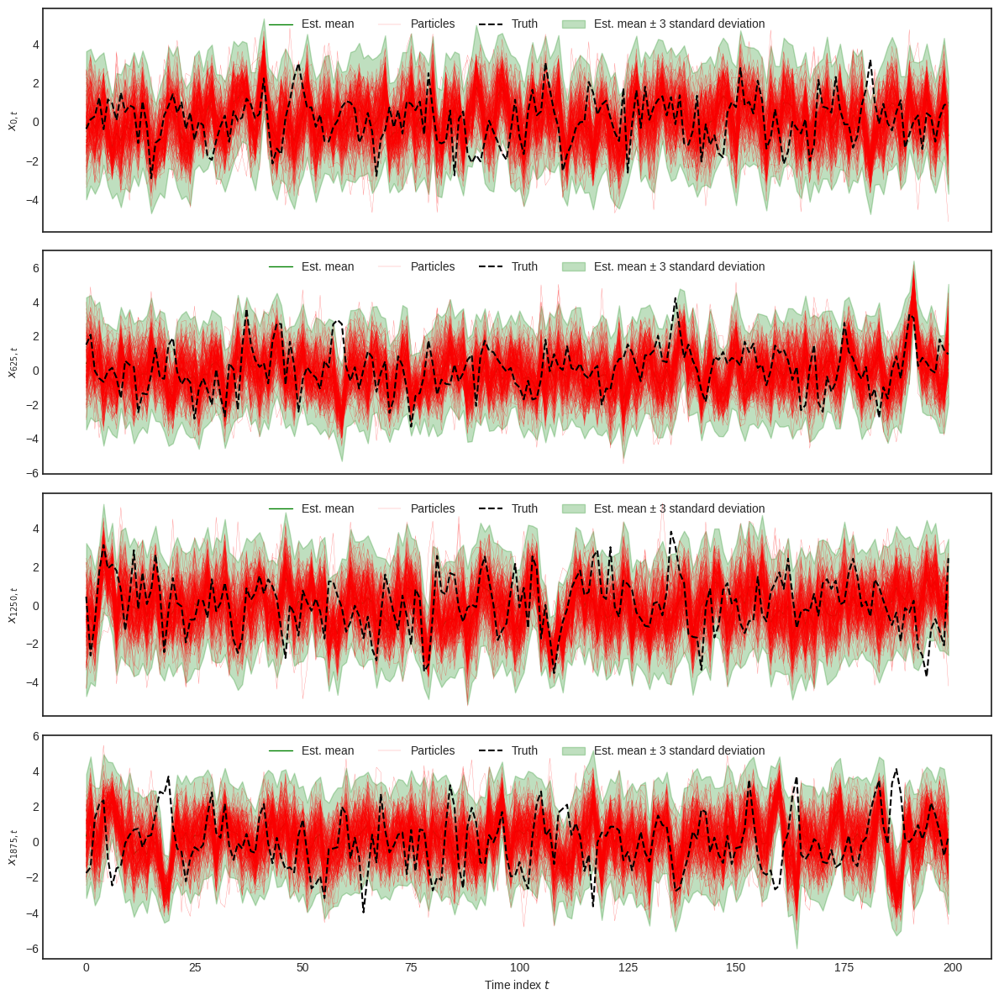

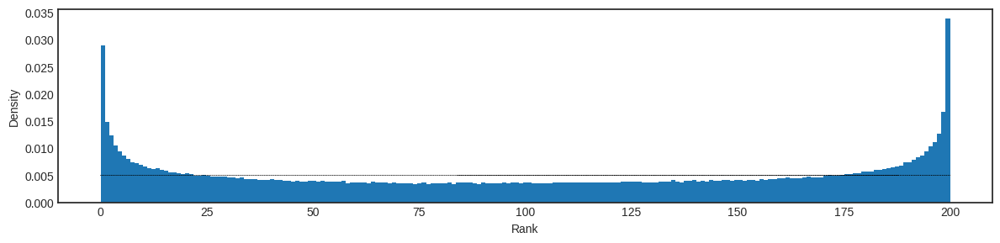

Particle filter


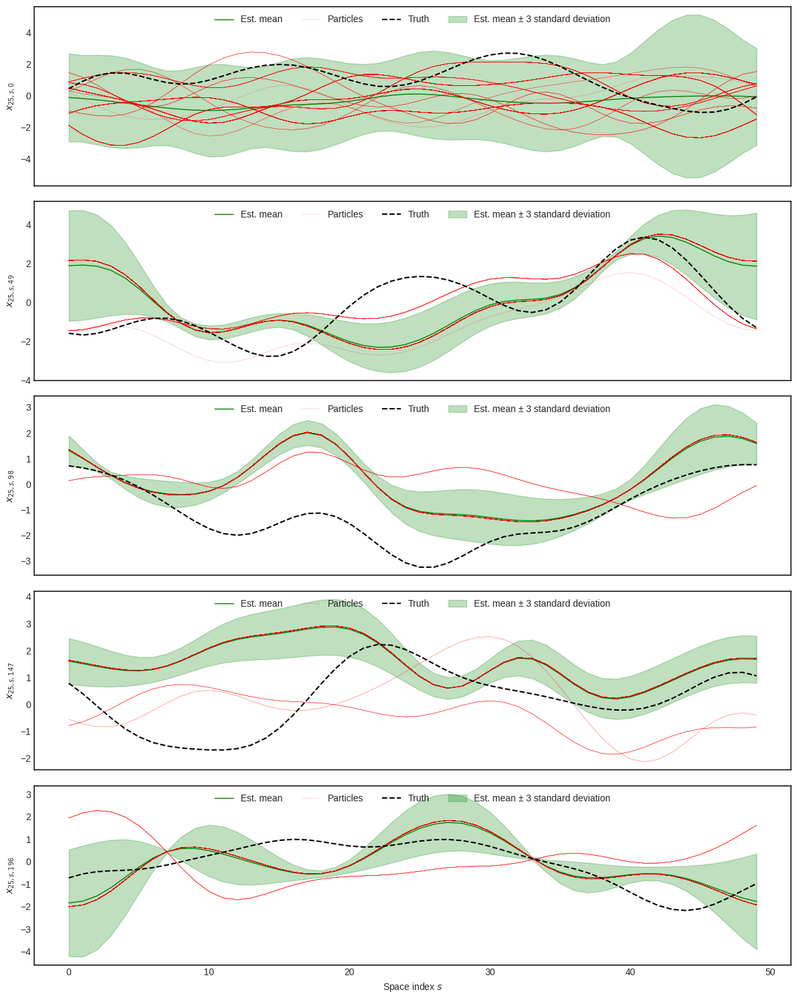

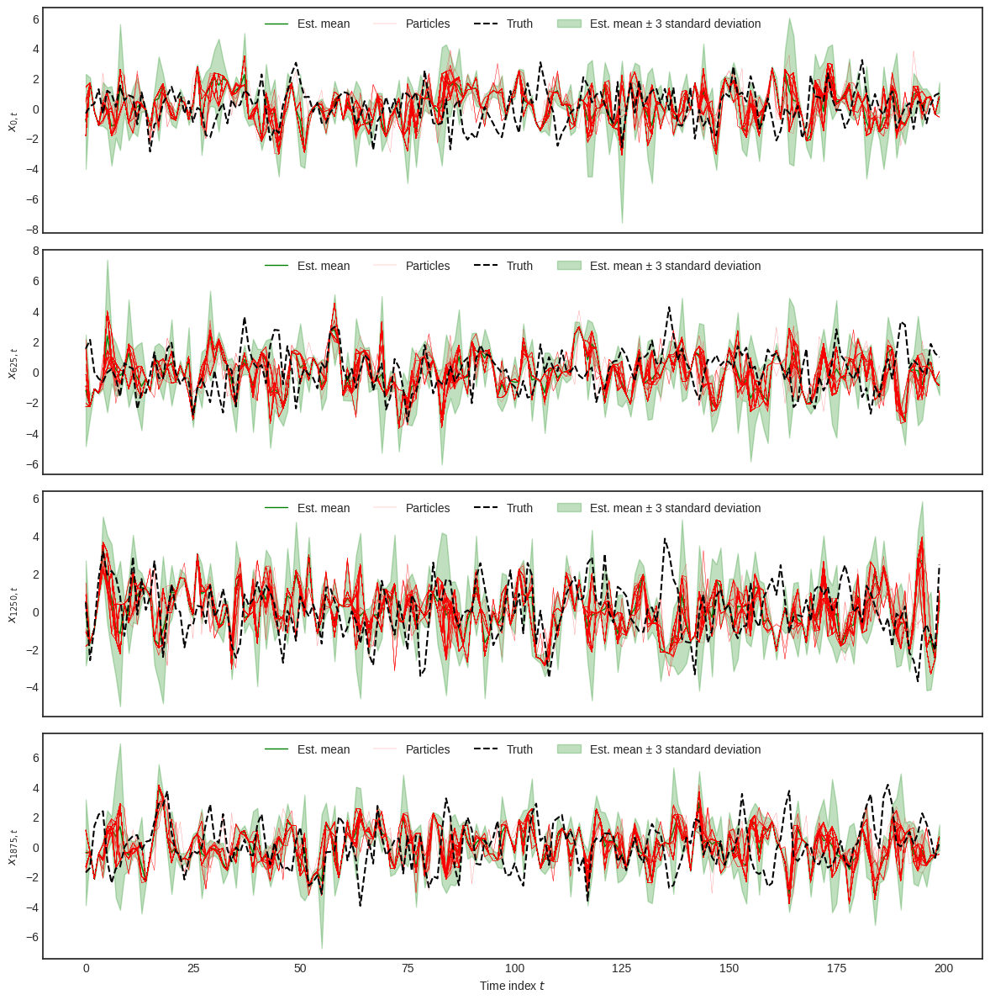

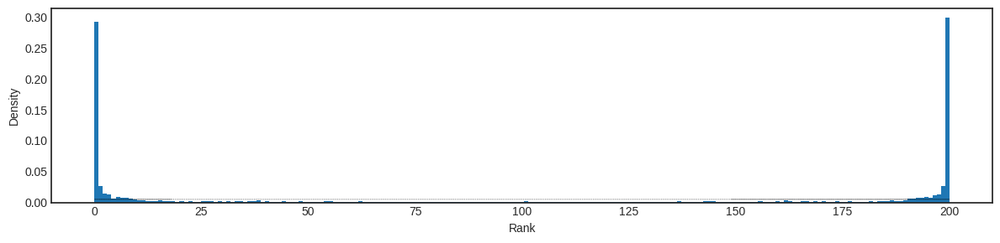

Local ensemble transform Kalman filter


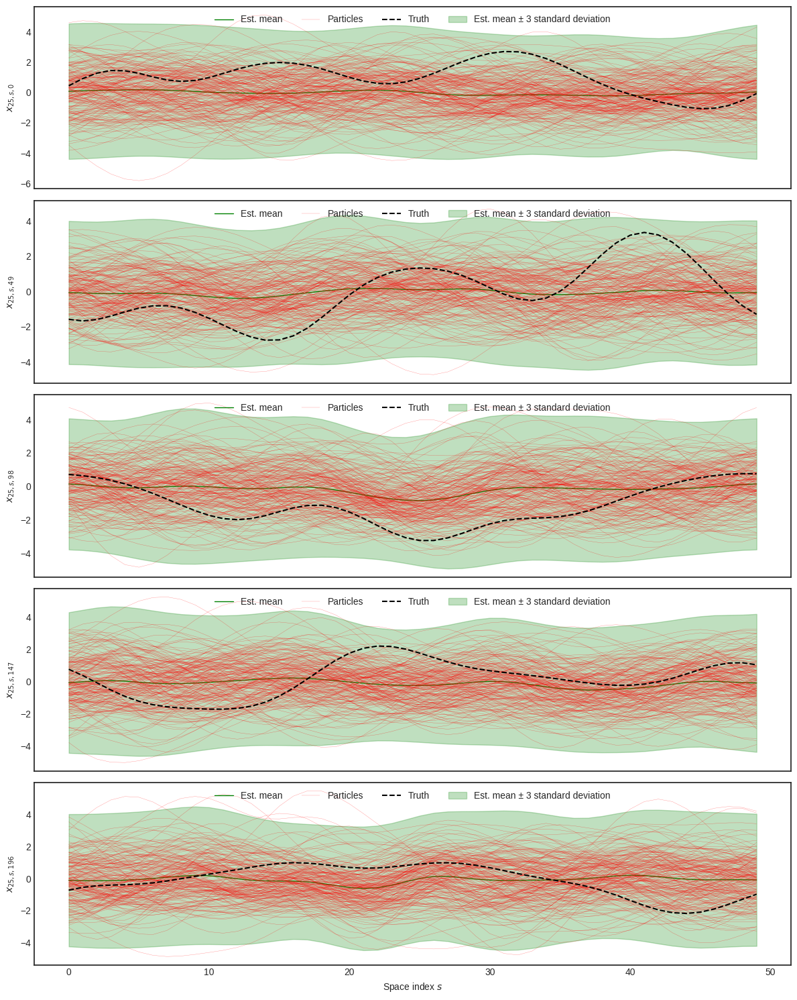

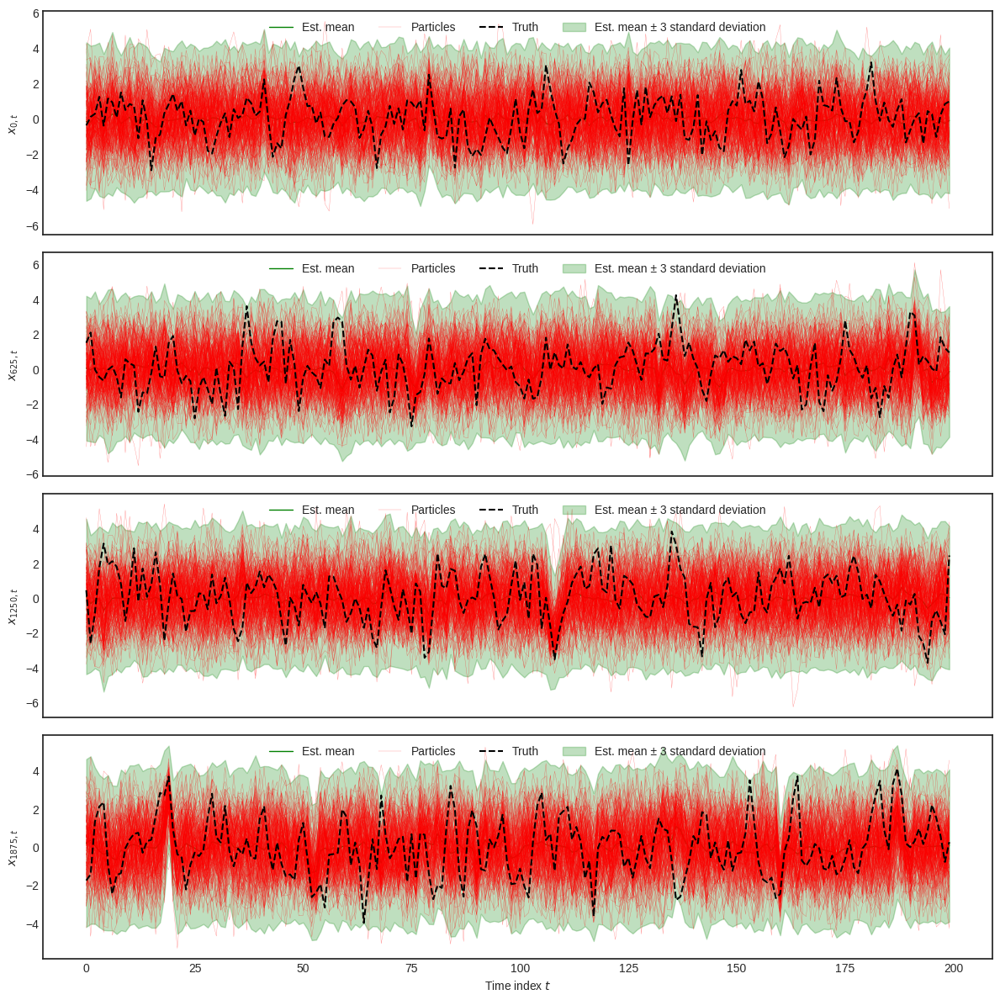

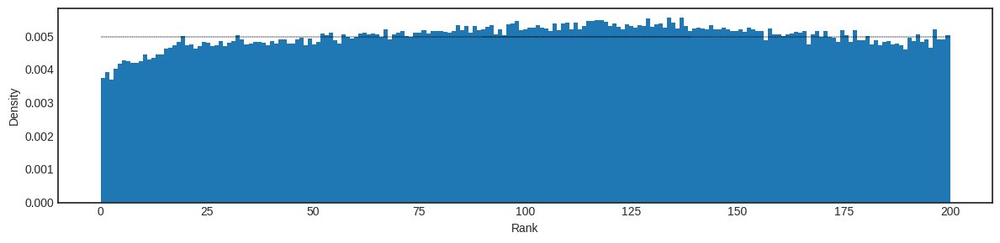

Local ensemble transform particle filter


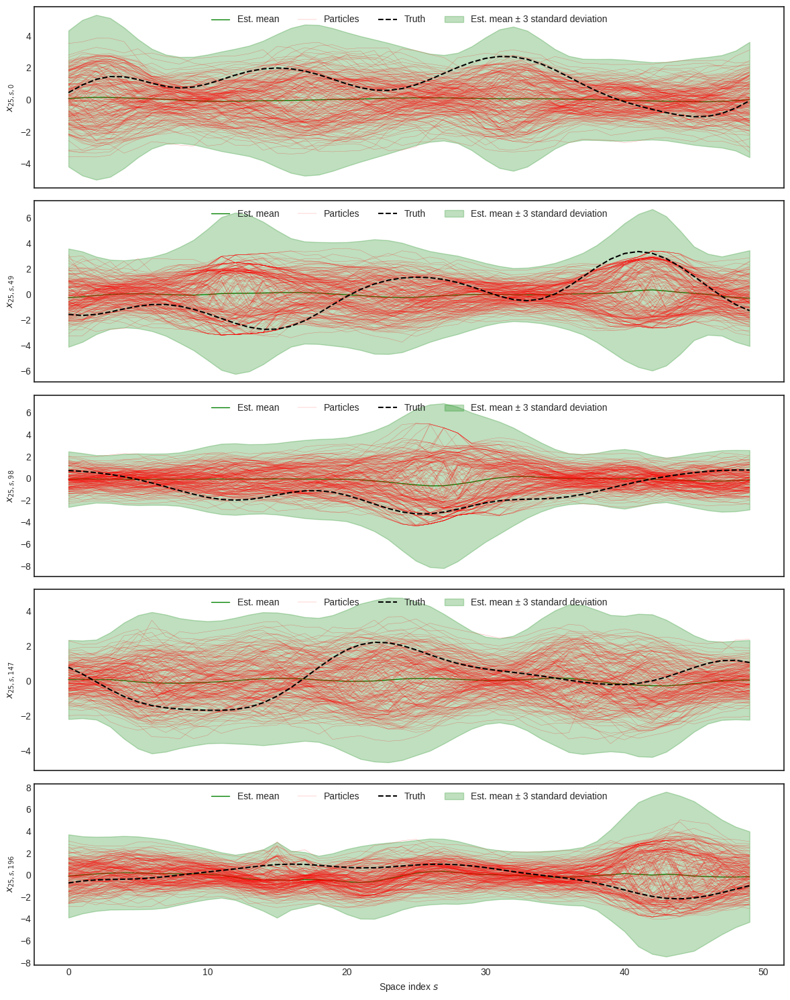

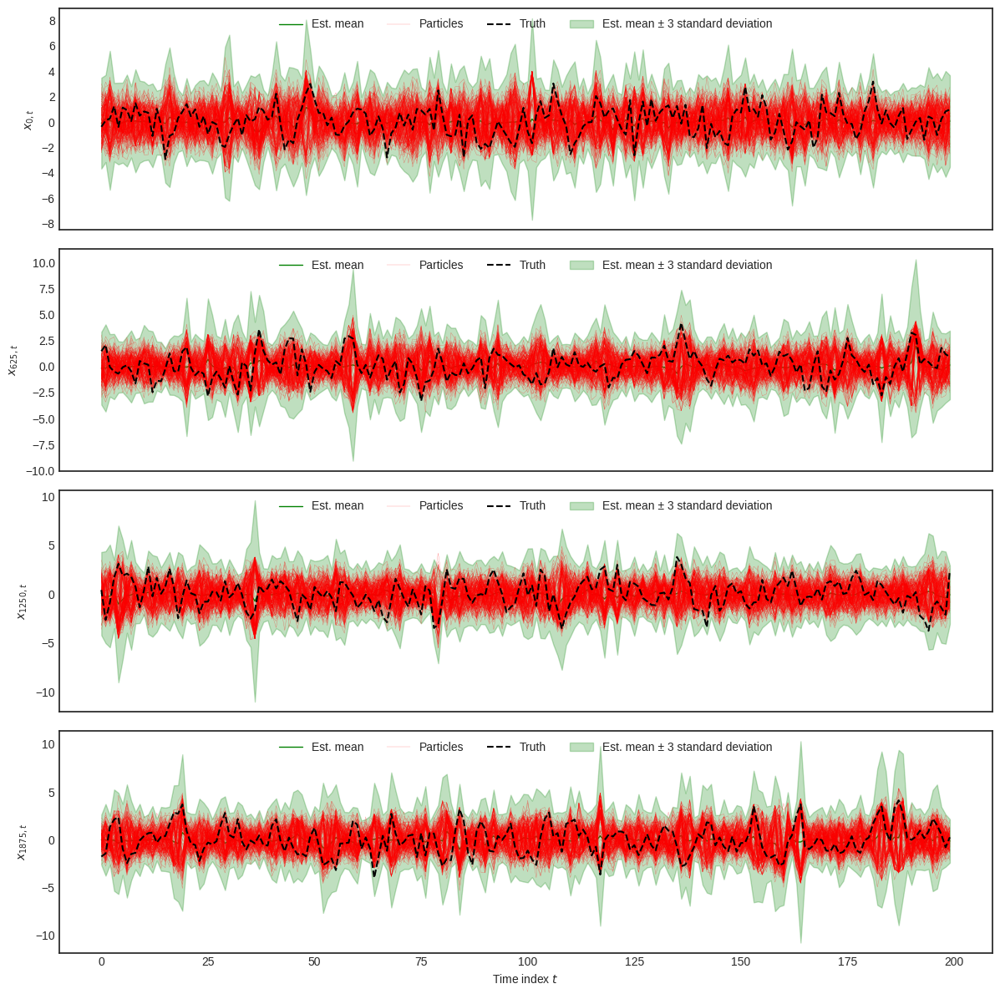

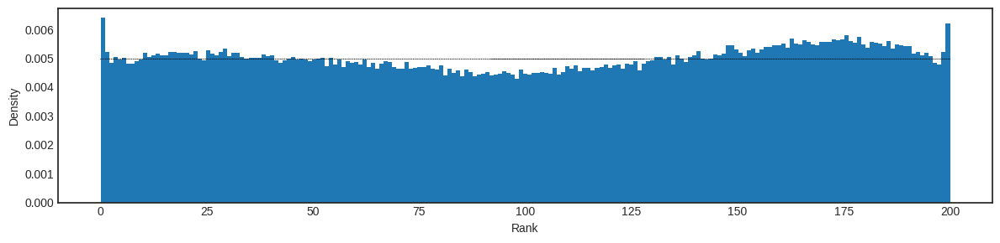

Smooth local ensemble transform particle filter


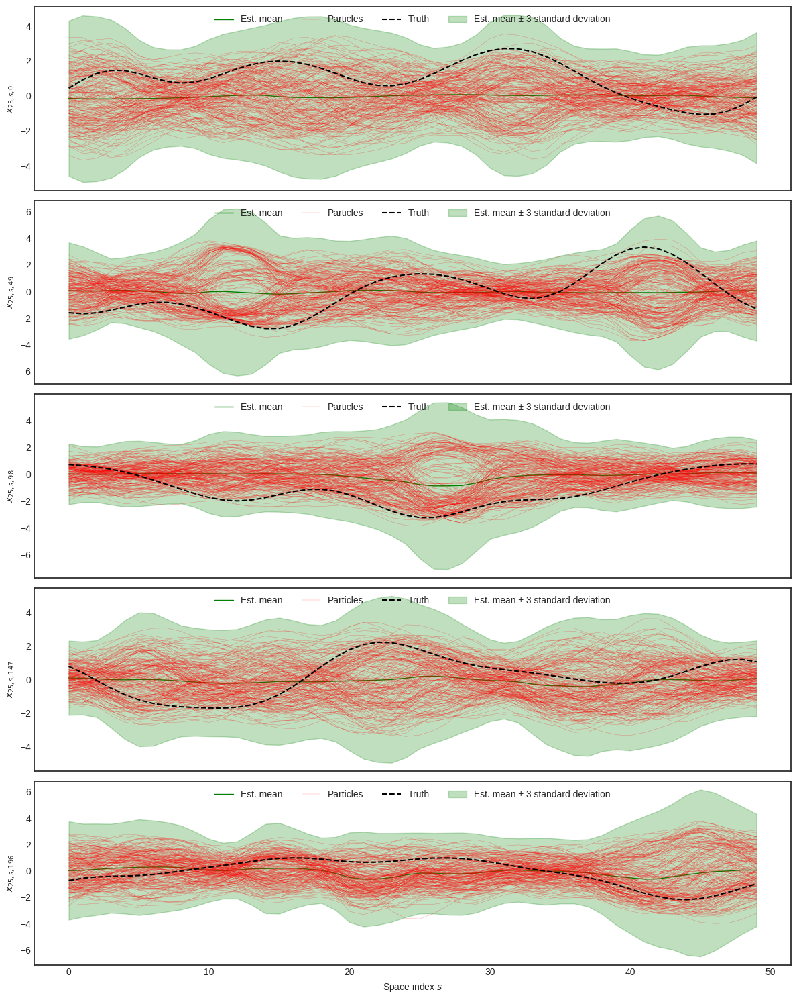

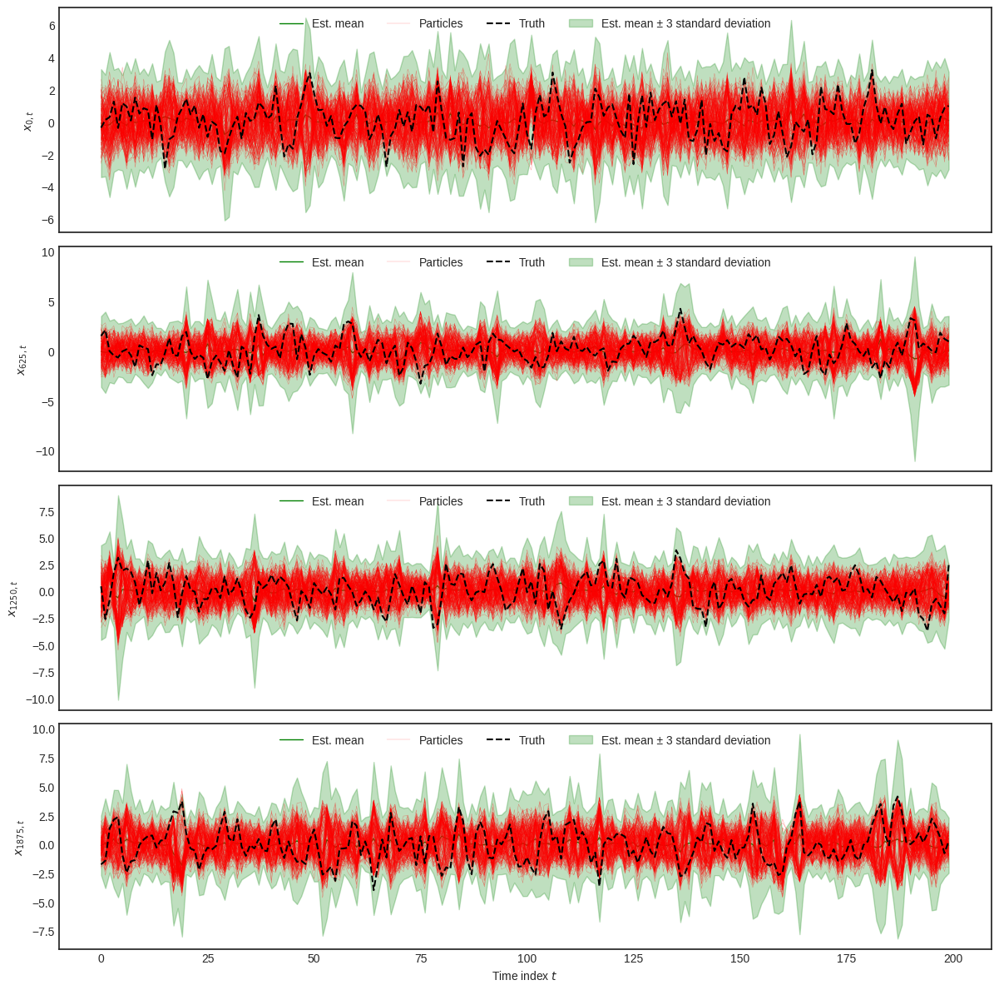

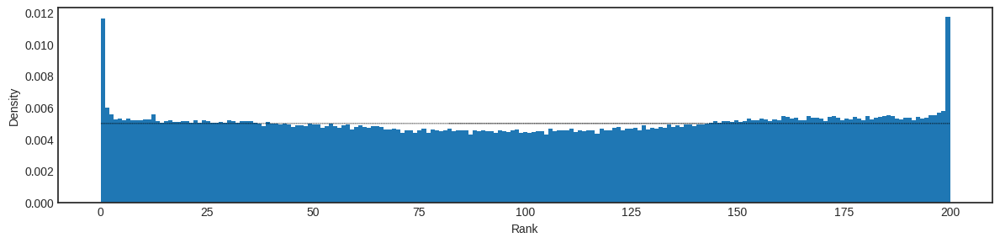

In [18]:
for label, results in ensemble_filter_results.items():
    print(label)
    plot_filter_results(results, state_sequence, model)